# Import Library

In [1]:
import tensorflow as tf
import keras
from keras import layers
from keras import ops
from collections import Counter

import numpy as np
import random
import os
import shutil

import cv2
import matplotlib.pyplot as plt
from PIL import Image

from scipy.linalg import sqrtm
import pandas as pd

from tensorflow.keras.applications.inception_v3 import InceptionV3, preprocess_input

SEED_VALUE = 1234
np.random.seed(SEED_VALUE)
tf.random.set_seed(SEED_VALUE)
random.seed(SEED_VALUE)

In [2]:
image_size = 100
test_dir = "3/test"
num_classes = 6

# Google Drive Import

In [3]:

from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
!cp /content/drive/MyDrive/3.zip /content/

In [5]:
!unzip 3.zip

Streaming output truncated to the last 5000 lines.
  inflating: 3/train/freshapples/rotated_by_45_Screen Shot 2018-06-08 at 5.09.40 PM.png  
  inflating: 3/train/freshapples/rotated_by_45_Screen Shot 2018-06-08 at 5.09.54 PM.png  
  inflating: 3/train/freshapples/rotated_by_45_Screen Shot 2018-06-08 at 5.12.14 PM.png  
  inflating: 3/train/freshapples/rotated_by_45_Screen Shot 2018-06-08 at 5.12.41 PM.png  
  inflating: 3/train/freshapples/rotated_by_45_Screen Shot 2018-06-08 at 5.13.18 PM.png  
  inflating: 3/train/freshapples/rotated_by_45_Screen Shot 2018-06-08 at 5.13.25 PM.png  
  inflating: 3/train/freshapples/rotated_by_45_Screen Shot 2018-06-08 at 5.13.31 PM.png  
  inflating: 3/train/freshapples/rotated_by_45_Screen Shot 2018-06-08 at 5.14.07 PM.png  
  inflating: 3/train/freshapples/rotated_by_45_Screen Shot 2018-06-08 at 5.14.20 PM.png  
  inflating: 3/train/freshapples/rotated_by_45_Screen Shot 2018-06-08 at 5.14.48 PM.png  
  inflating: 3/train/freshapples/rotated_by_45_Sc

In [6]:
!ls

3  3.zip  drive  sample_data


In [7]:
!ls /content

3  3.zip  drive  sample_data


In [8]:
image_dir = "3/train"

# EDA

In [9]:
IMG_SIZE = (100, 100)

train_ds = keras.utils.image_dataset_from_directory(
    "3/train",
    label_mode='int',
    image_size=IMG_SIZE,
    shuffle=False,
    batch_size=None,
)

val_ds = keras.utils.image_dataset_from_directory(
    "3/validation",
    label_mode='int',
    image_size=IMG_SIZE,
    shuffle=False,
    batch_size=None,
)

test_ds = keras.utils.image_dataset_from_directory(
    "3/test",
    label_mode='int',
    image_size=IMG_SIZE,
    shuffle=False,
    batch_size=None,
)


Found 2778 files belonging to 6 classes.
Found 2353 files belonging to 6 classes.
Found 88 files belonging to 6 classes.


Setelah meload dataset dapat terlihat bahwa :
- Distribusinya tidak ideal dimana data validasi dan data teks jumlahnya hampir sama
- Test set terlalu sedikit yang bisa membuat skor fid jelek

Disini langkah yang akan diambil, kita akan biarkan saja karena keterbatasan instruksi boleh mengubah data split atau tidak,  cuman memang disini akan dicatat bahwa nilai fid untuk test akan sedikit bias ke depannya karena data test hanya sedikit

In [10]:
import numpy as np

all_labels = []
for _, label in train_ds:
    all_labels.append(label.numpy())

print("All unique labels in dataset:", np.unique(all_labels))
print("Number of classes:", len(np.unique(all_labels)))


All unique labels in dataset: [0 1 2 3 4 5]
Number of classes: 6


In [11]:
base_dir = "3"
splits = ["train", "validation", "test"]
classes = os.listdir(os.path.join(base_dir, "train"))

data = []
for split in splits:
    for cls in classes:
        path = os.path.join(base_dir, split, cls)
        count = len(os.listdir(path))
        data.append([split, cls, count])

df = pd.DataFrame(data, columns=["Split", "Class", "Count"])

In [12]:
df

,Split,Class,Count
0,train,rottenoranges,458
1,train,rottenapples,477
2,train,freshoranges,543
3,train,rottenbanana,456
4,train,freshapples,460
5,train,freshbanana,384
6,validation,rottenoranges,390
7,validation,rottenapples,400
8,validation,freshoranges,388
9,validation,rottenbanana,410


Train :
- Cukup seimbang antar kelas
- Model seharusnya bisa belajar dengan semua kelas secara cukup seimbang

Validation :
- Cukup seimbang antar kelas dengan perbedaan sekitar ~30

Test :
- Test dataset terlalu kecil, nilai FID bisa menjadi bias
- Namun, kita tidak boleh mengganti dataset test karena fungsinya hanya untuk evaluasi jadi disini tidak akan dilakukan oversampling/augmentasi pada data test

In [13]:
!pip install opencv-python-headless

In [14]:
extensions = []

for img_list in os.listdir(image_dir):
    for img_name in os.listdir(image_dir + "/" + img_list):
      ext = img_name.split(".")[-1]
      extensions.append(ext)

print(Counter(extensions))


Counter({'png': 2778})


Extension sudah benar, yaitu dalam png

In [15]:
color_modes = []

for img_list in os.listdir(image_dir):
    for img_name in os.listdir(image_dir + "/" + img_list):
      img_path = os.path.join(image_dir,img_list ,img_name)
      img = cv2.imread(img_path)

      if img is None:
          continue

      if len(img.shape) == 2:
          color_modes.append("Grayscale")
      elif len(img.shape) == 3 and img.shape[2] == 3:
          color_modes.append("RGB")
      else:
          color_modes.append("Other")

print(Counter(color_modes))


Counter({'RGB': 2778})


Semua warna dalam bentuk RGB

({512, 514, 516, 518, 520, 522, 524, 526, 528, 530, 532, 534, 536, 538, 542, 544, 546, 548, 550, 554, 556, 558, 560, 562, 564, 566, 568, 570, 572, 574, 576, 578, 580, 582, 584, 586, 588, 590, 592, 594, 596, 598, 600, 602, 604, 606, 608, 610, 612, 614, 616, 618, 622, 624, 626, 628, 630, 632, 634, 636, 638, 640, 642, 644, 646, 648, 650, 652, 654, 144, 656, 146, 658, 150, 664, 152, 154, 666, 668, 160, 674, 676, 164, 678, 680, 168, 170, 682, 684, 174, 686, 176, 178, 690, 180, 692, 182, 694, 696, 184, 186, 188, 700, 190, 192, 706, 194, 196, 708, 198, 200, 202, 716, 206, 208, 720, 210, 212, 214, 216, 218, 730, 220, 222, 734, 224, 226, 738, 228, 740, 230, 232, 234, 746, 236, 238, 750, 240, 242, 244, 246, 758, 248, 250, 762, 252, 764, 254, 766, 256, 258, 260, 772, 262, 774, 264, 266, 268, 272, 274, 786, 276, 278, 790, 280, 282, 284, 796, 286, 288, 290, 292, 294, 296, 298, 300, 302, 304, 306, 308, 310, 312, 314, 316, 318, 320, 322, 324, 326, 328, 840, 330, 332, 334, 336, 338, 340, 342, 344, 346

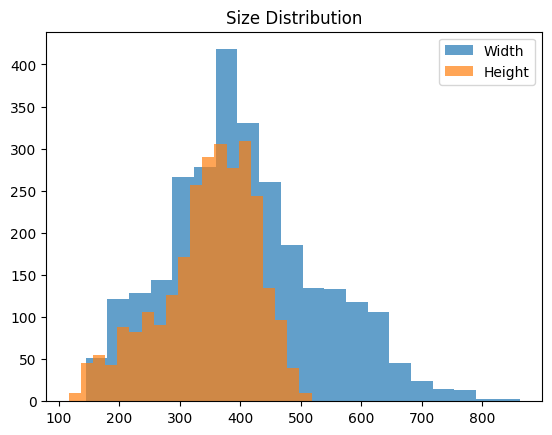

In [16]:
sizes = []

for img_list in os.listdir(image_dir):
    for img_name in os.listdir(image_dir + "/" + img_list):
      img_path = os.path.join(image_dir,img_list ,img_name)
      img = cv2.imread(img_path)
      if img is not None:
          h, w, _ = img.shape
          sizes.append((w, h))

widths, heights = zip(*sizes)
size = ((set(widths), set(heights)))
print(size)
plt.hist(widths, bins=20, alpha=0.7, label='Width')
plt.hist(heights, bins=20, alpha=0.7, label='Height')
plt.legend()
plt.title("Size Distribution")
plt.show()

Sizenya masih berbeda-beda, dapat dilakukan resizing ke 100x100 sebelum trainning

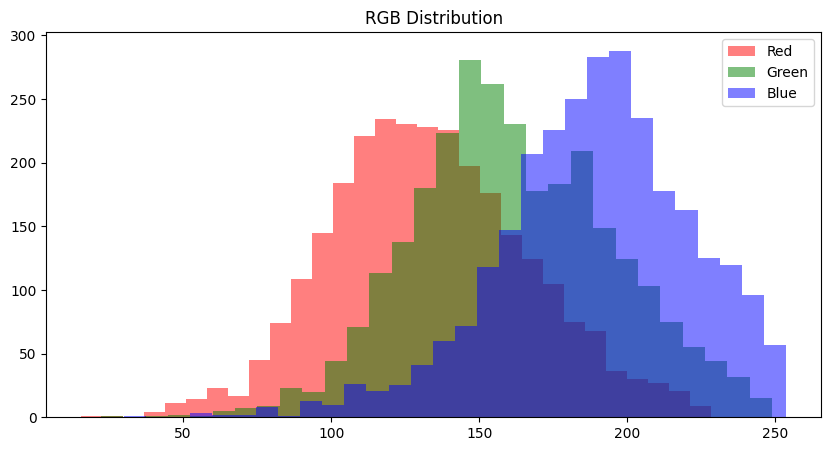

In [17]:
means = []
for img_list in os.listdir(image_dir):
    for img_name in os.listdir(image_dir + "/" + img_list):
      img = cv2.imread(os.path.join(image_dir,img_list ,img_name))
      if img is not None:
          means.append(cv2.mean(img)[:3])

means = np.array(means)
plt.figure(figsize=(10,5))
plt.hist(means[:,0], bins=30, color='r', alpha=0.5, label='Red')
plt.hist(means[:,1], bins=30, color='g', alpha=0.5, label='Green')
plt.hist(means[:,2], bins=30, color='b', alpha=0.5, label='Blue')
plt.legend()
plt.title("RGB Distribution")
plt.show()


Mayoritas nilai RGB terkonsentrasi di rentang menengah berarti pencahayaan dataset cukup seimbang

Tidak ada peak di 0 dan 255 berarti tidak ada gambar rusak, dataset realtif bersih

Banyak overlap antara Red, Green, dan Blue yang berarti dataset tidak bias terhadap warna tertentu

Selanjutnya, Karena distribusi RGB cukup baik, normalisasi tambahan tidak diperlukan pakai yang standar sudah cukup

Note : Jika melakukan augmentasi, karena distribusi rgb sudah baik augmentasi tidak bertujuan utama untuk warna

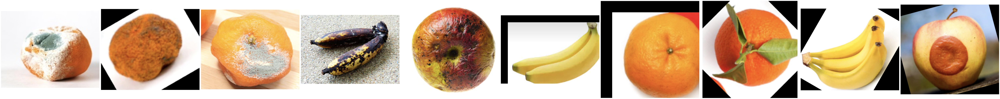

In [18]:
random.seed(2)

all_imgs = []
for subfolder in os.listdir(image_dir):
    sub_path = os.path.join(image_dir, subfolder)
    for img_name in os.listdir(sub_path):
          all_imgs.append(os.path.join(sub_path, img_name))
sample_imgs = random.sample(all_imgs, 10)

plt.figure(figsize=(100, 10))
for i, img_path in enumerate(sample_imgs):
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    plt.subplot(1, 10, i + 1)
    plt.imshow(img)
    plt.axis("off")

plt.tight_layout()
plt.show()


Gambar dataset cukup bervariasi, ada yang busuk dan segar. Lalu juga jenis buahnya cukup bervariasi.

Namun, background yang tidak konsisten dapat membuat jadi noise. Lalu, disini juga dapat terlihat ada beberapa image yang memiliki area hitam di pinggir yang merupakan hasil rotasi augmentasi yang terlalu ekstrem dan background yang ada juga tidak konsisten (tidak putih semua ada juga yang kayu misalnya), bahkan beberapa image juga jadinya terpotong

Solusi : Center Crop dataset untuk meminimalisir pola gambar bagian hitam di pigngiran gambar dan melakukan augmentasi agar model bisa belajar tentang background yang berbeda-beda

In [19]:
val_dir = "3/validation"

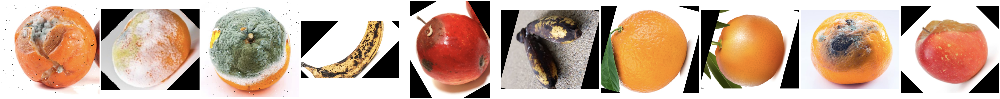

In [20]:
random.seed(2)

all_imgs = []
for subfolder in os.listdir(val_dir):
    sub_path = os.path.join(val_dir, subfolder)
    for img_name in os.listdir(sub_path):
          all_imgs.append(os.path.join(sub_path, img_name))
sample_imgs = random.sample(all_imgs, 10)

plt.figure(figsize=(100, 10))
for i, img_path in enumerate(sample_imgs):
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    plt.subplot(1, 10, i + 1)
    plt.imshow(img)
    plt.axis("off")

plt.tight_layout()
plt.show()


Kondisi sama seperti data train dimana ada hasil augmentasi ekstrem,terutama rotasi

In [21]:
test_dir = "3/test"

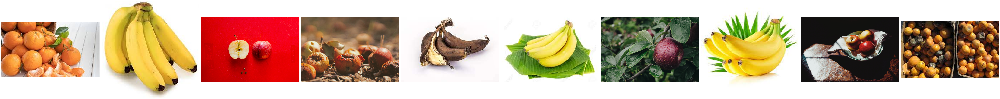

In [22]:
random.seed(3)

all_imgs = []
for subfolder in os.listdir(test_dir):
    sub_path = os.path.join(test_dir, subfolder)
    for img_name in os.listdir(sub_path):
          all_imgs.append(os.path.join(sub_path, img_name))
sample_imgs = random.sample(all_imgs, 10)

plt.figure(figsize=(100, 10))
for i, img_path in enumerate(sample_imgs):
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    plt.subplot(1, 10, i + 1)
    plt.imshow(img)
    plt.axis("off")

plt.tight_layout()
plt.show()


Data test backgroundnya lumayan noisy padahal dibutuhkan data yang bagus untuk menilai FID skor dengan tepat. Lalu, data test tidak ditemukan adanya tambahan augmentasi seperti train & val

# Preprocessing

In [23]:
def center_crop(image, frac=0.9):
    h, w = tf.shape(image)[0], tf.shape(image)[1]
    ch = tf.cast(tf.cast(h, tf.float32) * frac, tf.int32)
    cw = tf.cast(tf.cast(w, tf.float32) * frac, tf.int32)

    y0 = (h - ch) // 2
    x0 = (w - cw) // 2

    return image[y0:y0+ch, x0:x0+cw]


In [24]:
num_classes = 6
target_size = (100, 100)

def preprocess_image_label(image, label):
    image = center_crop(image)
    image = tf.image.resize(image, target_size)
    image = tf.cast(image, tf.float32) / 127.5 - 1.0
    label = tf.one_hot(tf.cast(label, tf.int32), depth=num_classes)
    return image, label

dataset_train = train_ds.map(preprocess_image_label)
dataset_val   = val_ds.map(preprocess_image_label)
dataset_test  = test_ds.map(preprocess_image_label)


In [25]:
batch_size = 8
dataset_train = dataset_train.batch(batch_size)
dataset_val   = dataset_val.batch(batch_size)
dataset_test  = dataset_test.batch(batch_size)

In [26]:
for images, labels in dataset_val.take(1):
    print("Images shape:", images.shape)
    print("Labels shape:", labels.shape)

Images shape: (8, 100, 100, 3)
Labels shape: (8, 6)


In [27]:
for images_batch, labels_batch in dataset_train.take(1):
    print("Image min:", tf.reduce_min(images_batch).numpy())
    print("Image max:", tf.reduce_max(images_batch).numpy())
    print("Label shape:", labels_batch.shape)

Image min: -0.9510784
Image max: 1.0
Label shape: (8, 6)


Image dijadiin range [-1,1] karena output Generator pakai tanh

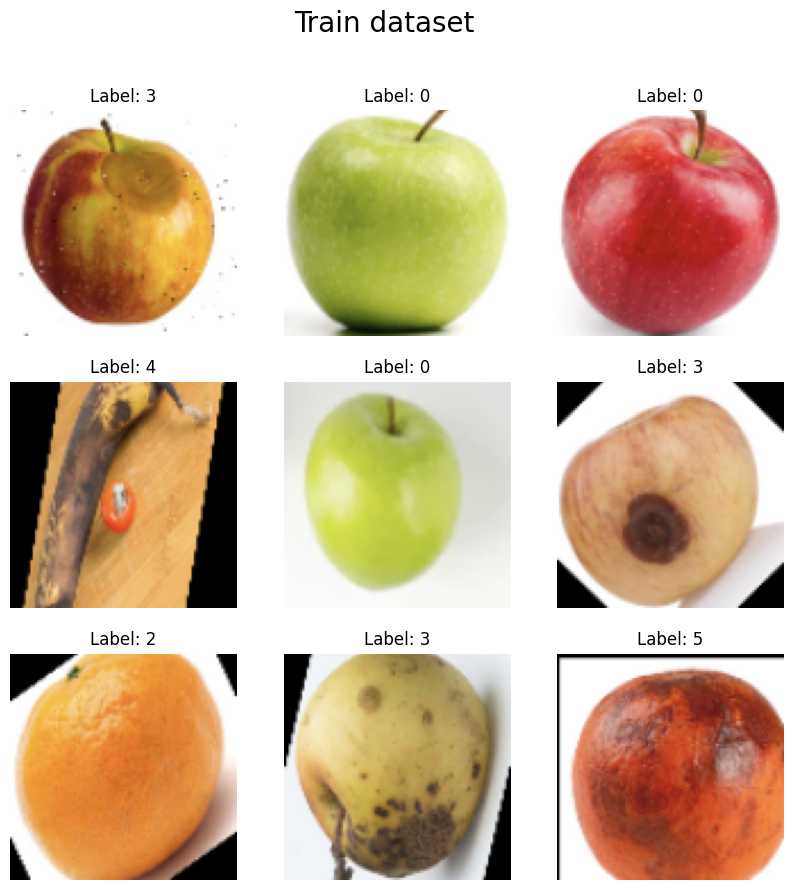

In [28]:
dataset_flat = dataset_train.unbatch()
dataset_flat = dataset_flat.shuffle(3000)

images_list = []
labels_list = []

for i, (img, lbl) in enumerate(dataset_flat.take(9)):
    images_list.append(img)
    labels_list.append(lbl)

images = tf.stack(images_list).numpy()
labels_idx = np.argmax(tf.stack(labels_list).numpy(), axis=1)

images = ((images + 1.0) * 127.5).astype(np.uint8)

plt.figure(figsize=(10,10))
plt.suptitle("Train dataset", fontsize=20)
for i in range(9):
    plt.subplot(3,3,i+1)
    plt.imshow(images[i])
    plt.title(f"Label: {labels_idx[i]}")
    plt.axis("off")
plt.show()


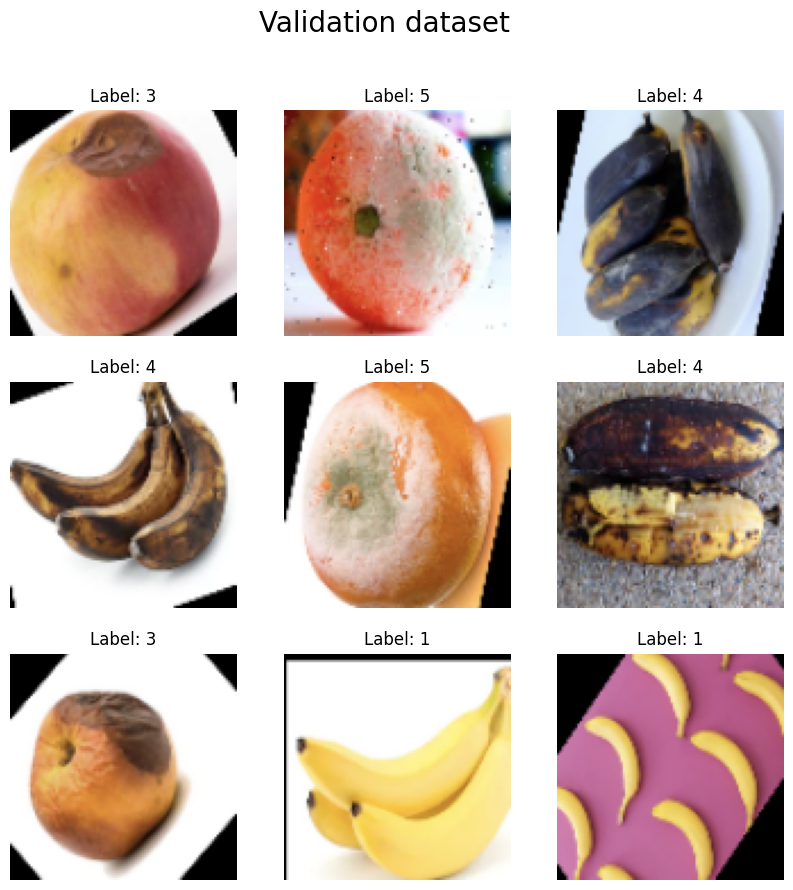

In [29]:
dataset_flat = dataset_val.unbatch()
dataset_flat = dataset_flat.shuffle(3000)

images_list = []
labels_list = []

for i, (img, lbl) in enumerate(dataset_flat.take(9)):
    images_list.append(img)
    labels_list.append(lbl)

images = tf.stack(images_list).numpy()
labels_idx = np.argmax(tf.stack(labels_list).numpy(), axis=1)

images = ((images + 1.0) * 127.5).astype(np.uint8)

plt.figure(figsize=(10,10))
plt.suptitle("Validation dataset", fontsize=20)
for i in range(9):
    plt.subplot(3,3,i+1)
    plt.imshow(images[i])
    plt.title(f"Label: {labels_idx[i]}")
    plt.axis("off")
plt.show()


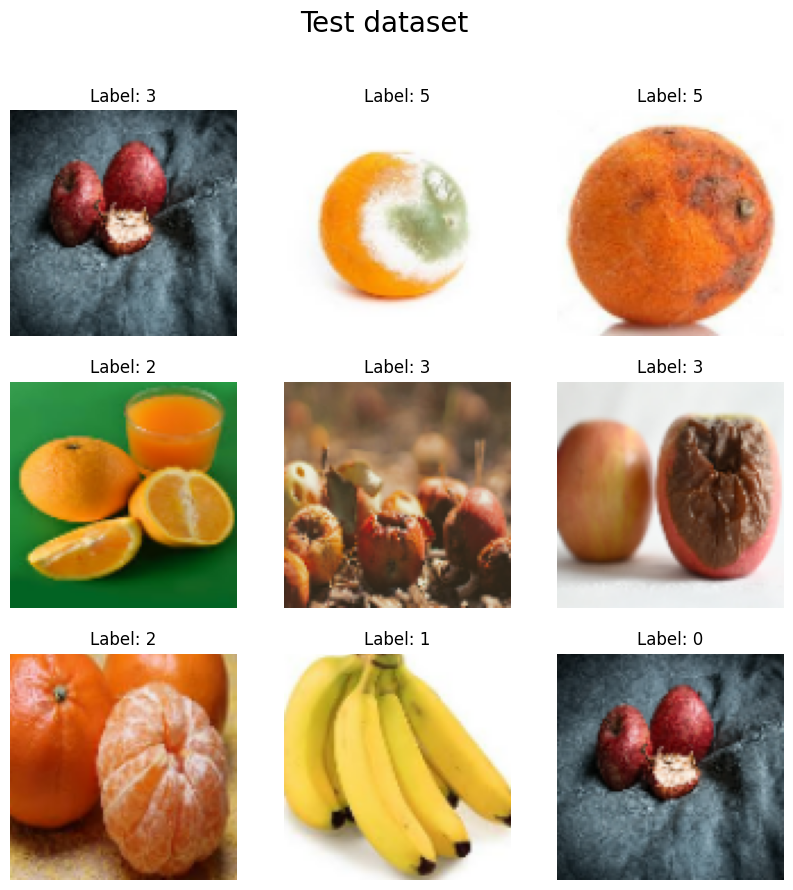

In [30]:
dataset_flat = dataset_test.unbatch()
dataset_flat = dataset_flat.shuffle(3000)

images_list = []
labels_list = []

for i, (img, lbl) in enumerate(dataset_flat.take(9)):
    images_list.append(img)
    labels_list.append(lbl)

images = tf.stack(images_list).numpy()
labels_idx = np.argmax(tf.stack(labels_list).numpy(), axis=1)

images = ((images + 1.0) * 127.5).astype(np.uint8)

plt.figure(figsize=(10,10))
plt.suptitle("Test dataset", fontsize=20)
for i in range(9):
    plt.subplot(3,3,i+1)
    plt.imshow(images[i])
    plt.title(f"Label: {labels_idx[i]}")
    plt.axis("off")
plt.show()


Setelah dilakukan center crop, memang masih ada bagian hitam tetapi lebih sedikit minimal (center crop tidak ditambah agar tidak terlalu memotong gambar buah)

In [31]:
data_augmentation = tf.keras.Sequential([
    tf.keras.layers.RandomFlip("horizontal"),
    tf.keras.layers.RandomRotation(0.02),
])


In [32]:
dataset_train_final = dataset_train.map(
    lambda x, y: (data_augmentation(x, training=True), y)
)

# First Model

In [33]:
discriminatorFirst = keras.Sequential(
    [
        keras.Input(shape=(100, 100, 3 + num_classes)),

        layers.Conv2D(64, kernel_size=4, strides=2, padding="same"),
        layers.ReLU(),

        layers.Conv2D(128, kernel_size=4, strides=2, padding="same"),
        layers.ReLU(),

        layers.Conv2D(256, kernel_size=4, strides=2, padding="same"),
        layers.ReLU(),

        layers.Flatten(),
        layers.Dense(1, activation="sigmoid"),
    ],
    name="discriminator",
)

discriminatorFirst.summary()

Model: "discriminator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 50, 50, 64)     │         9,280 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu (ReLU)                    │ (None, 50, 50, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 25, 25, 128)    │       131,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_1 (ReLU)                  │ (None, 25, 25, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 13, 13, 256)    │       524,544 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_2 (ReLU)                  │ (None, 13, 13, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 43264)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 1)              │        43,265 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 708,289 (2.70 MB)

 Trainable params: 708,289 (2.70 MB)

 Non-trainable params: 0 (0.00 B)

In [34]:
latent_dim_first = 32
num_classes = 6
input_dim_generator_first = latent_dim_first + num_classes

generatorFirst = keras.Sequential(
    [
        keras.Input(shape=(input_dim_generator_first,)),

        layers.Dense(25 * 25 * 512, use_bias=False),
        layers.ReLU(),

        layers.Reshape((25, 25, 512)),

        layers.Conv2DTranspose(256, kernel_size=4, strides=2, padding="same", use_bias=False),
        layers.ReLU(),

        layers.Conv2DTranspose(128, kernel_size=4, strides=2, padding="same", use_bias=False),
        layers.ReLU(),

        layers.Conv2D(64, kernel_size=3, padding="same"),
        layers.ReLU(),

        layers.Conv2D(32, kernel_size=3, padding="same"),
        layers.ReLU(),

        layers.Conv2D(
            3, kernel_size=5, padding="same", activation="tanh"
        ),
    ],
    name="generator",
)

generatorFirst.summary()


Model: "generator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_1 (Dense)                 │ (None, 320000)         │    12,160,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_3 (ReLU)                  │ (None, 320000)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ reshape (Reshape)               │ (None, 25, 25, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose                │ (None, 50, 50, 256)    │     2,097,152 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_4 (ReLU)                  │ (None, 50, 50, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_1              │ (None, 100, 100, 128)  │       524,288 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_5 (ReLU)                  │ (None, 100, 100, 128)  │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 100, 100, 64)   │        73,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_6 (ReLU)                  │ (None, 100, 100, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 100, 100, 32)   │        18,464 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_7 (ReLU)                  │ (None, 100, 100, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 100, 100, 3)    │         2,403 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 14,876,099 (56.75 MB)

 Trainable params: 14,876,099 (56.75 MB)

 Non-trainable params: 0 (0.00 B)

# CGAN

In [35]:
class ConditionalGAN(keras.Model):
    def __init__(self, discriminator, generator, latent_dim):
        super().__init__()
        self.discriminator = discriminator
        self.generator = generator
        self.latent_dim = latent_dim
        self.seed_generator = keras.random.SeedGenerator(1337)
        self.gen_loss_tracker = keras.metrics.Mean(name="generator_loss")
        self.disc_loss_tracker = keras.metrics.Mean(name="discriminator_loss")

    @property
    def metrics(self):
        return [self.gen_loss_tracker, self.disc_loss_tracker]

    def compile(self, d_optimizer, g_optimizer, loss_fn):
        super().compile()
        self.d_optimizer = d_optimizer
        self.g_optimizer = g_optimizer
        self.loss_fn = loss_fn

    def train_step(self, data):
        # Unpack the data.
        real_images, one_hot_labels = data

        # Add dummy dimensions to the labels so that they can be concatenated with
        # the images. This is for the discriminator.
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = ops.repeat(
            image_one_hot_labels, repeats=[image_size * image_size]
        )
        image_one_hot_labels = ops.reshape(
            image_one_hot_labels, (-1, image_size, image_size, num_classes)
        )

        # Sample random points in the latent space and concatenate the labels.
        # This is for the generator.
        batch_size = ops.shape(real_images)[0]
        random_latent_vectors = keras.random.normal(
            shape=(batch_size, self.latent_dim), seed=self.seed_generator
        )
        random_vector_labels = ops.concatenate(
            [random_latent_vectors, one_hot_labels], axis=1
        )

        # Decode the noise (guided by labels) to fake images.
        generated_images = self.generator(random_vector_labels)

        # Combine them with real images. Note that we are concatenating the labels
        # with these images here.
        fake_image_and_labels = ops.concatenate(
            [generated_images, image_one_hot_labels], -1
        )
        real_image_and_labels = ops.concatenate([real_images, image_one_hot_labels], -1)
        combined_images = ops.concatenate(
            [fake_image_and_labels, real_image_and_labels], axis=0
        )

        # Assemble labels discriminating real from fake images.
        labels = ops.concatenate(
            [ops.ones((batch_size, 1)), ops.zeros((batch_size, 1))], axis=0
        )

        # Train the discriminator.
        with tf.GradientTape() as tape:
            predictions = self.discriminator(combined_images)
            d_loss = self.loss_fn(labels, predictions)
        grads = tape.gradient(d_loss, self.discriminator.trainable_weights)
        self.d_optimizer.apply_gradients(
            zip(grads, self.discriminator.trainable_weights)
        )

        # Sample random points in the latent space.
        random_latent_vectors = keras.random.normal(
            shape=(batch_size, self.latent_dim), seed=self.seed_generator
        )
        random_vector_labels = ops.concatenate(
            [random_latent_vectors, one_hot_labels], axis=1
        )

        # Assemble labels that say "all real images".
        misleading_labels = ops.zeros((batch_size, 1))

        # Train the generator (note that we should *not* update the weights
        # of the discriminator)!
        with tf.GradientTape() as tape:
            fake_images = self.generator(random_vector_labels)
            fake_image_and_labels = ops.concatenate(
                [fake_images, image_one_hot_labels], -1
            )
            predictions = self.discriminator(fake_image_and_labels)
            g_loss = self.loss_fn(misleading_labels, predictions)
        grads = tape.gradient(g_loss, self.generator.trainable_weights)
        self.g_optimizer.apply_gradients(zip(grads, self.generator.trainable_weights))

        # Monitor loss.
        self.gen_loss_tracker.update_state(g_loss)
        self.disc_loss_tracker.update_state(d_loss)
        return {
            "g_loss": self.gen_loss_tracker.result(),
            "d_loss": self.disc_loss_tracker.result(),
        }

# CGAN Monitor

In [36]:
class CGANMonitor(keras.callbacks.Callback):
    def __init__(self, latent_dim, num_classes, num_img=3, val_dataset=None,image_size=(100,100)):
        self.num_img = num_img
        self.latent_dim = latent_dim
        self.num_classes = num_classes
        self.val_dataset = val_dataset
        self.image_size = image_size
        self.seed = tf.random.normal((num_img, latent_dim))
        self.labels = tf.one_hot(tf.range(num_img) % num_classes, num_classes)

    def on_epoch_end(self, epoch, logs=None):
        random_vector_labels = tf.concat([self.seed, self.labels], axis=1)
        generated_images = self.model.generator(random_vector_labels, training=False)
        generated_images = (generated_images * 127.5 + 127.5).numpy().astype("uint8")

        for i in range(self.num_img):
            img = keras.utils.array_to_img(generated_images[i])
            img.save(f"generated_img_epoch{epoch+1}_{i}.png")

        if self.val_dataset is not None:
            for val_images, val_labels in self.val_dataset.take(1):
                if val_labels.shape[-1] != self.num_classes:
                    val_labels = tf.one_hot(tf.cast(val_labels, tf.int32), self.num_classes)

                image_one_hot_labels = tf.reshape(val_labels[:, None, None, :],
                                                  (val_images.shape[0], 1, 1, self.num_classes))
                image_one_hot_labels = tf.tile(image_one_hot_labels,
                                               [1, self.image_size[0], self.image_size[1], 1])

                real_input = tf.concat([val_images, image_one_hot_labels], axis=-1)

                predictions = self.model.discriminator(real_input, training=False)
                val_d_loss = self.model.loss_fn(tf.ones_like(predictions), predictions)

                if logs is not None:
                    logs["val_d_loss"] = val_d_loss.numpy()

                print(f" [VAL] Epoch {epoch+1}: val_d_loss = {val_d_loss.numpy():.4f}")


# Train

In [37]:
cond_gan = ConditionalGAN(
    discriminator=discriminatorFirst, generator=generatorFirst, latent_dim=latent_dim_first
)
cond_gan.compile(
    d_optimizer = keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5),
    g_optimizer = keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5),
    loss_fn=keras.losses.BinaryCrossentropy(from_logits = False),
)

history = cond_gan.fit(
    dataset_train_final,
    epochs=100,
    callbacks=[CGANMonitor(latent_dim=latent_dim_first, num_classes=6, val_dataset=dataset_val)],
  )

Epoch 1/100
348/348 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step - d_loss: 0.3243 - g_loss: 3.5971 [VAL] Epoch 1: val_d_loss = 3.3315
348/348 ━━━━━━━━━━━━━━━━━━━━ 53s 110ms/step - d_loss: 0.3244 - g_loss: 3.5967 - val_d_loss: 3.3315
Epoch 2/100
347/348 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step - d_loss: 0.4914 - g_loss: 1.9977 [VAL] Epoch 2: val_d_loss = 0.8715
348/348 ━━━━━━━━━━━━━━━━━━━━ 31s 88ms/step - d_loss: 0.4917 - g_loss: 1.9963 - val_d_loss: 0.8715
Epoch 3/100
347/348 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step - d_loss: 0.4880 - g_loss: 1.8194 [VAL] Epoch 3: val_d_loss = 2.7958
348/348 ━━━━━━━━━━━━━━━━━━━━ 30s 86ms/step - d_loss: 0.4884 - g_loss: 1.8182 - val_d_loss: 2.7958
Epoch 4/100
347/348 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step - d_loss: 0.5333 - g_loss: 1.5019 [VAL] Epoch 4: val_d_loss = 1.0347
348/348 ━━━━━━━━━━━━━━━━━━━━ 30s 87ms/step - d_loss: 0.5335 - g_loss: 1.5015 - val_d_loss: 1.0347
Epoch 5/100
347/348 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step - d_loss: 0.5508 - g_loss: 1.5013 [VAL] Epoch 5: val_d_loss 

# Evaluation

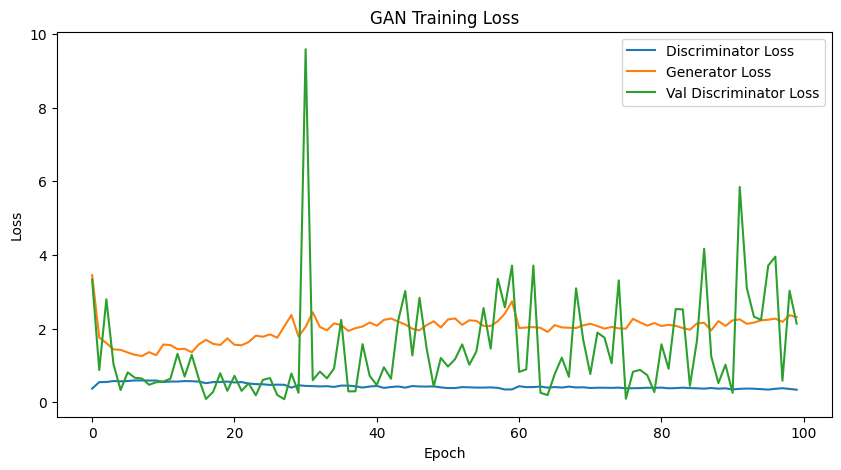

In [38]:
plt.figure(figsize=(10, 5))

plt.plot(history.history["d_loss"], label="Discriminator Loss")
plt.plot(history.history["g_loss"], label="Generator Loss")
plt.plot(history.history["val_d_loss"], label="Val Discriminator Loss")

plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("GAN Training Loss")
plt.legend()
plt.show()


Analisis grafik:

- Discriminator loss (train): stabil rendah (~0.3 - ~0.5)

- Generator loss: cenderung naik dan fluktuatif (~2 - ~3.5)

- Val discriminator loss: sangat fluktuatif sampai membuat spike besar (hampir 10)

Interpretasi :

- Discriminator loss yang rendah menandakan kalau discriminator mampu membedakan data real dan fake dengan sangat baik. Akan tetapi, Discriminator terlalu banyak menghafal data training (Overfitting) sehingga tidak mengeneralisasi dengan baik. Hal ini ditandai dengan val discriminator loss yang cenderung naik turun fluktuatif. Hal ini juga dapat menjadi indikasi kalau discriminator terlalu kuat 

- Generator loss yang cenderung naik terus menandakan generator masih kesulitan untuk menipu discriminator kemungkinan indikasi kalau generator masih terlalu lemah

Solusi : 

- Discriminator masih terlalu overconfident, mungkin bisa tambahkan dropout atau mengubah relu jadi leaky relu agar discriminator tidak overconfident

- Perkuat Generator, bisa dengan menambahkan latent dim atau penambahan batch normalization



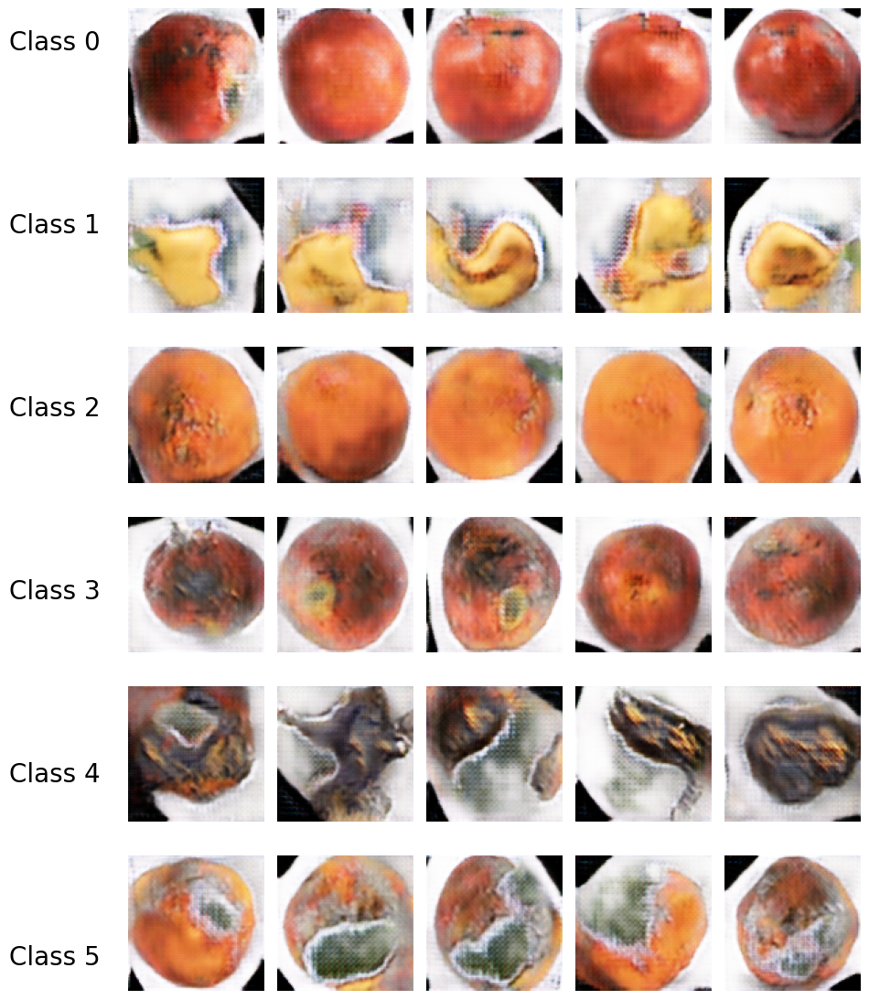

In [ ]:
num_classes = 6
latent_dim = latent_dim_first
n_per_class = 5

noise = tf.random.normal([num_classes * n_per_class, latent_dim])

labels = tf.repeat(tf.range(num_classes), repeats=n_per_class)
labels_one_hot = tf.one_hot(labels, num_classes)

generator_input = tf.concat([noise, labels_one_hot], axis=1)

images = generatorFirst(generator_input, training=False)
images = (images + 1) / 2.0  

fig, axes = plt.subplots(num_classes, n_per_class, figsize=(n_per_class*2, num_classes*2))
plt.subplots_adjust(left=0.15, right=0.95, top=0.95, bottom=0.05, hspace=0.2, wspace=0.1)

for i in range(num_classes):
    for j in range(n_per_class):
        idx = i * n_per_class + j
        ax = axes[i, j]
        ax.imshow(images[idx])
        ax.axis("off")

    fig.text(0.02, 1 - (i + 0.5)/num_classes, f"Class {i}", va='center', fontsize=20)

plt.show()


Inspeksi Manual :

1. Class 0 - Fresh Apple

- Bentuk sudah bulat dan warna merah
- Background kurang bersih (ada bagian hitam di pinggir)
- Tekstur masih sedikit blur dan kurang tajam
- Gambar sudah mulai terlihat seperti apel

2. Class 1 - Fresh Banana

- Bentuk pisang masih belum berbentuk jelas
- Warna kuning sudah muncul, tetapi struktur masih salah
- Background kurang bersih (ada bagian hitam di pinggir)
- Gambar masih belum mirip bentuk pisang

3. Class 2 - Fresh Orange

- Bentuk sudah bulat dan warna oranye
- Tekstur masih sedikit blur dan kurang tajam
- Background kurang bersih (ada bagian hitam di pinggir)
- Beberapa sudah cukup terlihat seperti jeruk

4. Class 3 - Rotten Apple

- Bentuk sudah mulai berbentuk seperti apel
- Warna merah dan bercak hitam/hijau juga mulai terlihat
- Ciri-ciri kebusukan sudah mulai terlihat jelas
- Tekstur masih sedikit blur dan kurang tajam
- Background kurang bersih (ada bagian hitam di pinggir)
- Gambar sudah mulai terlihat seperti apel busuk


5. Class 4 - Rotten Banana

- Bentuk pisang busuk masih belum berbentuk jelas
- Warna kuning yang dibutuhkan sudah cukup, tetapi struktur masih salah
- Ciri-ciri kebusukan juga sudah mulai jelas, tetapi strukturnya masih salah
- Background kurang bersih (ada bagian hitam di pinggir)
- Gambar masih belum mirip pisang busuk

6. Class 5 - Rotten Orange

- Bentuk sudah bulat dan warna oranye cukup baik
- Tekstur masih sedikit blur dan kurang tajam
- Background kurang bersih (ada bagian hitam di pinggir)
- Beberapa sudah cukup terlihat seperti jeruk
- Ciri-ciri kebusukan (kehijauan) sedikit cenderung terlalu berlebihan
- Gambar sedikit mirip berbentuk jeruk busuk

Analisis Global

- GAN mengenali objek bulat (apel & jeruk) jauh lebih baik dibandingkan objek memanjang & variatif (pisang)

- Semua kelas terdapat Blur dan background yang kurang bersih (bagian hitam di pinggir). Hal ini kemungkinan terjadi karena dataset memang sedikit blur dan memiliki bagian hitam di pinggir akibat augmentasi

- Ciri-ciri kebusukan sudah mulai terlihat, tetapi pada kelas orange rotten (Class 5) terlihat terlalu ekstrem


In [40]:
def load_images_from_folder(folder, img_size=(299, 299)):
    images = []
    for filename in os.listdir(folder):
        path = os.path.join(folder, filename)
        img = Image.open(path).convert('RGB')
        img = img.resize(img_size)
        img = np.array(img)
        images.append(img)
    return np.array(images)

In [41]:
def generate_fake_images(generator, latent_dim, num_images):
    noise = tf.random.normal([num_images, latent_dim])
    fake_images = generator(noise, training=False)
    fake_images = (fake_images + 1) / 2.0
    fake_images = fake_images * 255.0
    return tf.cast(fake_images, tf.uint8)


In [42]:
def get_real_images(dataset, num_images):
    images = []
    for batch in dataset:
        batch = (batch + 1) / 2.0
        batch = batch * 255.0
        images.append(tf.cast(batch, tf.uint8))
        if tf.concat(images, axis=0).shape[0] >= num_images:
            break
    return tf.concat(images, axis=0)[:num_images]


In [43]:
inception = InceptionV3(
    include_top=False,
    pooling="avg",
    input_shape=(299, 299, 3)
)


87910968/87910968 ━━━━━━━━━━━━━━━━━━━━ 5s 0us/step


In [44]:
def get_activations(images, model, batch_size=32):
    activations = []
    for i in range(0, images.shape[0], batch_size):
        batch = images[i:i+batch_size]
        batch = tf.image.resize(batch, (299, 299))
        batch = preprocess_input(tf.cast(batch, tf.float32))
        act = model(batch)
        activations.append(act)
    return tf.concat(activations, axis=0)


In [45]:
def calculate_fid_safe(real_images, fake_images, model, batch_size=32):
    act1 = get_activations(real_images, model, batch_size).numpy()
    act2 = get_activations(fake_images, model, batch_size).numpy()

    mu1, sigma1 = act1.mean(axis=0), np.cov(act1, rowvar=False)
    mu2, sigma2 = act2.mean(axis=0), np.cov(act2, rowvar=False)

    diff = mu1 - mu2
    covmean = sqrtm(sigma1.dot(sigma2))

    if np.iscomplexobj(covmean):
        covmean = covmean.real

    fid = diff.dot(diff) + np.trace(sigma1 + sigma2 - 2 * covmean)
    return fid


In [46]:
latent_dim_first = 32
fid_scores = {}

for class_name in os.listdir(test_dir):
    class_path = os.path.join(test_dir, class_name)
    print(f"Calculating FID for class: {class_name}")

    real_imgs = load_images_from_folder(class_path)

    fake_imgs = generate_fake_images(
        generatorFirst,
        latent_dim=latent_dim_first+num_classes,
        num_images=len(real_imgs)
    )

    fid = calculate_fid_safe(real_imgs, fake_imgs, model=inception)
    fid_scores[class_name] = fid
    print(f"FID for {class_name}: {fid:.2f}\n")


Calculating FID for class: rottenoranges
FID for rottenoranges: 399.21

Calculating FID for class: rottenapples
FID for rottenapples: 439.13

Calculating FID for class: freshoranges
FID for freshoranges: 471.72

Calculating FID for class: rottenbanana
FID for rottenbanana: 435.82

Calculating FID for class: freshapples
FID for freshapples: 418.63

Calculating FID for class: freshbanana
FID for freshbanana: 512.69



Analisis :
- Skor FID paling tinggi pada freshbanana, sedangkan skor FID paling rendah pada rottenoranges

- Pada setiap kelas, skor FID setiap kelas sangat tinggi (>350)

- Skor FID pada jeruk & apel (kecuali fresh orange) lebih kecil dibandingkan skor FID pada pisang

- Skor FID pada kelas rotten tidak selalu memiliki FID lebih tinggi dari kelas fresh

Interpretasi :
- Disini, model masih kesulitan dalam memahami bentuk pisang yang mengakibatkan nilai FID tinggi. Sebaliknya, model lebih paham memahami bentuk bulat jeruk dengan ciri kebusukan 

- Skor FID yang tinggi ini (terutama > 350) menandakan bahwa GAN belum menghasilkan gambar yang realistis. Padahal ini bertentangan dengan inspeksi yang telah kita lakukan sebelumnya. Akan tetapi, Hal ini wajar terjadi karena dataset test yang terlalu sedikit (88) dan dataset test yang masih terlalu noisy (terlalu banyak noise background). Akibatnya, perhitungan FID menjadi tidak stabil sehingga skor FID membengkak

- Walaupun FID tidak dapat dipakai sebagai perhitungan absolut, FID skor masih bisa dipakai untuk membandingkan perbedaan antar kelas

- Skor FID yang lebih rendah pada jeruk & apel daripada pisang sekali lagi menunjukan bahwa model GAN lebih mudah memahami bentuk bulat dibandingkan bentuk memanjang variatif

- Pada beberapa kelas, seperti fresh orange, skor FID malahan lebih tinggi dibandingkan kelas rotten orange. Hal ini kemungkinan terjadi karena visual kebusukan yang bersifat ekstrem lebih mudah dipelajari oleh GAN dibandingkan ciri visual objek fresh yang membutuhkan tekstur lebih halus

# Second Model

In [47]:
num_classes = 6

In [48]:
discriminator = keras.Sequential(
    [
        keras.Input(shape=(100, 100, 3 + num_classes)),

        layers.Conv2D(64, kernel_size=4, strides=2, padding="same"),
        layers.LeakyReLU(negative_slope=0.2),
        layers.Dropout(0.1),

        layers.Conv2D(128, kernel_size=4, strides=2, padding="same"),
        layers.LeakyReLU(negative_slope=0.2),
        layers.Dropout(0.1),

        layers.Conv2D(256, kernel_size=4, strides=2, padding="same"),
        layers.LeakyReLU(negative_slope=0.2),
        layers.Dropout(0.1),

        layers.Conv2D(512, kernel_size=4, strides=2, padding="same"),
        layers.LeakyReLU(negative_slope=0.2),
        layers.Dropout(0.1),

        layers.GlobalAveragePooling2D(),
        layers.Dense(1, activation="sigmoid"),
    ],
    name="discriminator",
)

discriminator.summary()



Model: "discriminator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_100 (Conv2D)             │ (None, 50, 50, 64)     │         9,280 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu (LeakyReLU)         │ (None, 50, 50, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 50, 50, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_101 (Conv2D)             │ (None, 25, 25, 128)    │       131,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_1 (LeakyReLU)       │ (None, 25, 25, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 25, 25, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_102 (Conv2D)             │ (None, 13, 13, 256)    │       524,544 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_2 (LeakyReLU)       │ (None, 13, 13, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 13, 13, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_103 (Conv2D)             │ (None, 7, 7, 512)      │     2,097,664 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_3 (LeakyReLU)       │ (None, 7, 7, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_3 (Dropout)             │ (None, 7, 7, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_1      │ (None, 512)            │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 1)              │           513 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,763,201 (10.54 MB)

 Trainable params: 2,763,201 (10.54 MB)

 Non-trainable params: 0 (0.00 B)

In [49]:
latent_dim = 64
num_classes = 6
input_dim_generator = latent_dim + num_classes

generator = keras.Sequential(
    [
        keras.Input(shape=(input_dim_generator,)),

        layers.Dense(25 * 25 * 512, use_bias=False),
        layers.BatchNormalization(),
        layers.ReLU(),

        layers.Reshape((25, 25, 512)),

        layers.Conv2DTranspose(256, kernel_size=4, strides=2, padding="same", use_bias=False),
        layers.BatchNormalization(),
        layers.ReLU(),

        layers.Conv2DTranspose(128, kernel_size=4, strides=2, padding="same", use_bias=False),
        layers.BatchNormalization(),
        layers.ReLU(),

        layers.Conv2D(64, kernel_size=3, padding="same"),
        layers.BatchNormalization(),
        layers.ReLU(),

        layers.Conv2D(64, kernel_size=3, padding="same"),
        layers.BatchNormalization(),
        layers.ReLU(),

        layers.Conv2D(
            3, kernel_size=5, padding="same", activation="tanh"
        ),
    ],
    name="generator",
)

generator.summary()


Model: "generator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_3 (Dense)                 │ (None, 320000)         │    22,400,000 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_94          │ (None, 320000)         │     1,280,000 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_8 (ReLU)                  │ (None, 320000)         │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ reshape_1 (Reshape)             │ (None, 25, 25, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_2              │ (None, 50, 50, 256)    │     2,097,152 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_95          │ (None, 50, 50, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_9 (ReLU)                  │ (None, 50, 50, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_3              │ (None, 100, 100, 128)  │       524,288 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_96          │ (None, 100, 100, 128)  │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_10 (ReLU)                 │ (None, 100, 100, 128)  │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_104 (Conv2D)             │ (None, 100, 100, 64)   │        73,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_97          │ (None, 100, 100, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_11 (ReLU)                 │ (None, 100, 100, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_105 (Conv2D)             │ (None, 100, 100, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_98          │ (None, 100, 100, 64)   │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_12 (ReLU)                 │ (None, 100, 100, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_106 (Conv2D)             │ (None, 100, 100, 3)    │         4,803 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 26,419,011 (100.78 MB)

 Trainable params: 25,777,987 (98.34 MB)

 Non-trainable params: 641,024 (2.45 MB)

Alasan modifikasi :
- Pada Discriminator, ditambahkan dropout agar mencegah overfitting dan mengurangi resiko mode collapse
- Pada Discriminator, diubah Relu menjadi LeakyRelu agar tidak terjadi kondisi vanishing gradient
- Pada Discriminator. ditambahkan layer convolution satu lagi agar model dapat menangkap fitur lebih pada gambar
- Pada discriminator, flatten diganti menjadi GlobalAveragePooling2D karena flatten mudah overfit pada dataset kecil (< 6000 data)

- Pada Generator, ditambahkan batch normalization agar training lebih stabil dan secara tidak langsung dapat mengurangi mode collapse
- Pada Generator, latent dim ditambahkan dari 32 menjadi 64 agar model dapat memahami gambar lebih baik (mencegah underfitting)

# CGAN

In [50]:
class ConditionalGAN3(keras.Model):
    def __init__(self, discriminator, generator, latent_dim):
        super().__init__()
        self.discriminator = discriminator
        self.generator = generator
        self.latent_dim = latent_dim
        self.seed_generator = keras.random.SeedGenerator(1337)
        self.gen_loss_tracker = keras.metrics.Mean(name="generator_loss")
        self.disc_loss_tracker = keras.metrics.Mean(name="discriminator_loss")

    @property
    def metrics(self):
        return [self.gen_loss_tracker, self.disc_loss_tracker]

    def compile(self, d_optimizer, g_optimizer, loss_fn):
        super().compile()
        self.d_optimizer = d_optimizer
        self.g_optimizer = g_optimizer
        self.loss_fn = loss_fn

    def train_step(self, data):
        # Unpack the data.
        real_images, one_hot_labels = data

        # Add dummy dimensions to the labels so that they can be concatenated with
        # the images. This is for the discriminator.
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = ops.repeat(
            image_one_hot_labels, repeats=[image_size * image_size]
        )
        image_one_hot_labels = ops.reshape(
            image_one_hot_labels, (-1, image_size, image_size, num_classes)
        )

        # Sample random points in the latent space and concatenate the labels.
        # This is for the generator.
        batch_size = ops.shape(real_images)[0]
        random_latent_vectors = keras.random.normal(
            shape=(batch_size, self.latent_dim), seed=self.seed_generator
        )
        random_vector_labels = ops.concatenate(
            [random_latent_vectors, one_hot_labels], axis=1
        )

        # Decode the noise (guided by labels) to fake images.
        generated_images = self.generator(random_vector_labels)

        # Combine them with real images. Note that we are concatenating the labels
        # with these images here.
        fake_image_and_labels = ops.concatenate(
            [generated_images, image_one_hot_labels], -1
        )
        real_image_and_labels = ops.concatenate([real_images, image_one_hot_labels], -1)
        combined_images = ops.concatenate(
            [fake_image_and_labels, real_image_and_labels], axis=0
        )

        # Assemble labels discriminating real from fake images.
        labels = ops.concatenate(
            [ops.ones((batch_size, 1)), ops.zeros((batch_size, 1))], axis=0
        )

        # Train the discriminator.
        with tf.GradientTape() as tape:
            predictions = self.discriminator(combined_images)
            d_loss = self.loss_fn(labels, predictions)
        grads = tape.gradient(d_loss, self.discriminator.trainable_weights)
        self.d_optimizer.apply_gradients(
            zip(grads, self.discriminator.trainable_weights)
        )

        # Sample random points in the latent space.
        random_latent_vectors = keras.random.normal(
            shape=(batch_size, self.latent_dim), seed=self.seed_generator
        )
        random_vector_labels = ops.concatenate(
            [random_latent_vectors, one_hot_labels], axis=1
        )

        # Assemble labels that say "all real images".
        misleading_labels = ops.zeros((batch_size, 1))

        # Train the generator (note that we should *not* update the weights
        # of the discriminator)!
        with tf.GradientTape() as tape:
            fake_images = self.generator(random_vector_labels)
            fake_image_and_labels = ops.concatenate(
                [fake_images, image_one_hot_labels], -1
            )
            predictions = self.discriminator(fake_image_and_labels)
            g_loss = self.loss_fn(misleading_labels, predictions)
        grads = tape.gradient(g_loss, self.generator.trainable_weights)
        self.g_optimizer.apply_gradients(zip(grads, self.generator.trainable_weights))

        # Monitor loss.
        self.gen_loss_tracker.update_state(g_loss)
        self.disc_loss_tracker.update_state(d_loss)
        return {
            "g_loss": self.gen_loss_tracker.result(),
            "d_loss": self.disc_loss_tracker.result(),
        }

In [51]:
class CGANMonitor(keras.callbacks.Callback):
    def __init__(self, latent_dim, num_classes, num_img=3, val_dataset=None,image_size=(100,100)):
        self.num_img = num_img
        self.latent_dim = latent_dim
        self.num_classes = num_classes
        self.val_dataset = val_dataset
        self.image_size = image_size
        self.seed = tf.random.normal((num_img, latent_dim))
        self.labels = tf.one_hot(tf.range(num_img) % num_classes, num_classes)

    def on_epoch_end(self, epoch, logs=None):
        random_vector_labels = tf.concat([self.seed, self.labels], axis=1)
        generated_images = self.model.generator(random_vector_labels, training=False)
        generated_images = (generated_images * 127.5 + 127.5).numpy().astype("uint8")

        for i in range(self.num_img):
            img = keras.utils.array_to_img(generated_images[i])
            img.save(f"generated_img_epoch{epoch+1}_{i}.png")

        if self.val_dataset is not None:
            for val_images, val_labels in self.val_dataset.take(1):
                if val_labels.shape[-1] != self.num_classes:
                    val_labels = tf.one_hot(tf.cast(val_labels, tf.int32), self.num_classes)

                image_one_hot_labels = tf.reshape(val_labels[:, None, None, :],
                                                  (val_images.shape[0], 1, 1, self.num_classes))
                image_one_hot_labels = tf.tile(image_one_hot_labels,
                                               [1, self.image_size[0], self.image_size[1], 1])

                real_input = tf.concat([val_images, image_one_hot_labels], axis=-1)

                predictions = self.model.discriminator(real_input, training=False)
                val_d_loss = self.model.loss_fn(tf.ones_like(predictions), predictions)

                if logs is not None:
                    logs["val_d_loss"] = val_d_loss.numpy()

                print(f" [VAL] Epoch {epoch+1}: val_d_loss = {val_d_loss.numpy():.4f}")


# Train

In [52]:
cond_gan = ConditionalGAN3(
    discriminator=discriminator, generator=generator, latent_dim=latent_dim
)
cond_gan.compile(
    d_optimizer = keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5),
    g_optimizer = keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5),
    loss_fn=keras.losses.BinaryCrossentropy(from_logits = False),
)

history = cond_gan.fit(
    dataset_train_final,
    epochs=100,
    callbacks=[CGANMonitor(latent_dim=latent_dim, num_classes=6, val_dataset=dataset_val)],
  )

Epoch 1/100
348/348 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step - d_loss: 0.4175 - g_loss: 2.8409 [VAL] Epoch 1: val_d_loss = 1.3038
348/348 ━━━━━━━━━━━━━━━━━━━━ 53s 120ms/step - d_loss: 0.4176 - g_loss: 2.8408 - val_d_loss: 1.3038
Epoch 2/100
347/348 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step - d_loss: 0.3665 - g_loss: 2.6103 [VAL] Epoch 2: val_d_loss = 0.8495
348/348 ━━━━━━━━━━━━━━━━━━━━ 35s 101ms/step - d_loss: 0.3669 - g_loss: 2.6085 - val_d_loss: 0.8495
Epoch 3/100
347/348 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step - d_loss: 0.6320 - g_loss: 1.0690 [VAL] Epoch 3: val_d_loss = 1.3598
348/348 ━━━━━━━━━━━━━━━━━━━━ 36s 104ms/step - d_loss: 0.6319 - g_loss: 1.0690 - val_d_loss: 1.3598
Epoch 4/100
347/348 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step - d_loss: 0.6649 - g_loss: 0.9368 [VAL] Epoch 4: val_d_loss = 0.7704
348/348 ━━━━━━━━━━━━━━━━━━━━ 37s 105ms/step - d_loss: 0.6648 - g_loss: 0.9371 - val_d_loss: 0.7704
Epoch 5/100
347/348 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step - d_loss: 0.6187 - g_loss: 0.9997 [VAL] Epoch 5: val_

# Evaluation

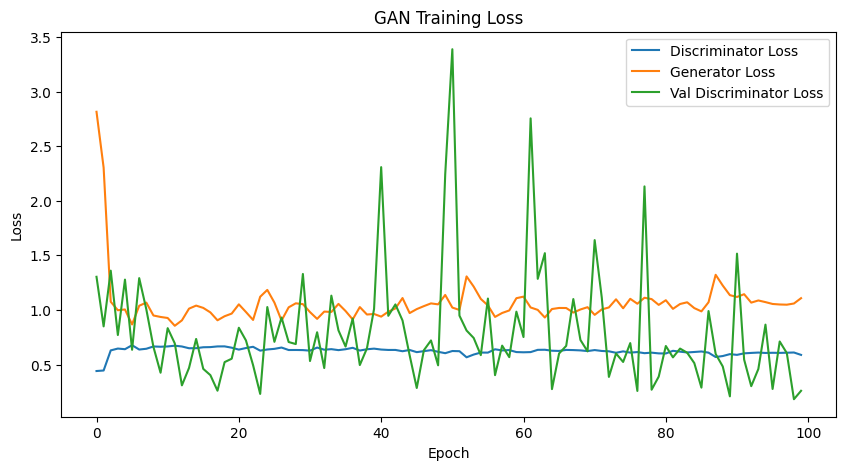

In [53]:
plt.figure(figsize=(10, 5))

plt.plot(history.history["d_loss"], label="Discriminator Loss")
plt.plot(history.history["g_loss"], label="Generator Loss")
plt.plot(history.history["val_d_loss"], label="Val Discriminator Loss")

plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("GAN Training Loss")
plt.legend()
plt.show()


Analisis grafik:

- Discriminator loss (train): cukup stabil berada di kisaran ~0.65, ini sedikit lebih tinggi dari model pertama

- Generator loss: awalnya turun dan stabil di kisaran ~0.9 - ~1.2 dengan sedikit fluktuasi

- Val discriminator loss: Masih fluktuatif, tetapi spikenya lebih kecil dibandingkan model pertama dan juga cenderung turun di akhir training

Interpretasi:

- Discriminator loss (train) cukup stabil dan tidak terlalu rendah menandakan discriminator tidak lagi terlalu dominan dan tidak terlalu overconfident dalam membedakan data real dan fake. Hal ini menandakan adanya keseimbangan yang lebih baik antara discriminator dan generator

- Val discriminator loss yang masih fluktuatif menunjukkan bahwa generalisasi discriminator belum sepenuhnya stabil. Akan tetapi, fluktuasi dan spike berhasil dikecilkan yang berarti overfitting pada discriminator berhasil dikurangi setelah penambahan dropout dan penggunaan GlobalAveragePooling2D

- Generator loss yang lebih stabil dan tidak terus meningkat menunjukkan bahwa generator mulai mampu mengikuti perkembangan discriminator. Hal ini berarti generator sekarang bisa menyaingi discriminator

- Pola loss pada grafik training GAN lebih seimbang dan lebih stabil. Hal ini terlihat dari kompetisi yang lebih stabil antara generator dan discriminator.

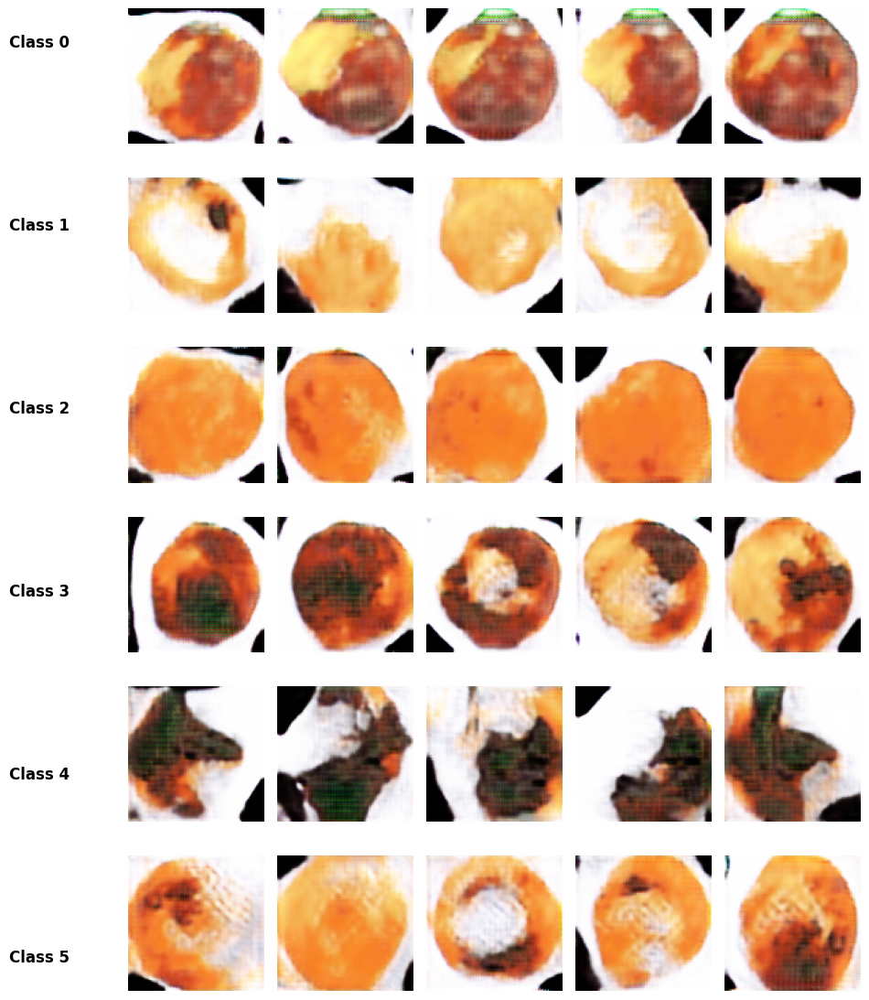

In [54]:
latent_dim = latent_dim
n_per_class = 5

noise = tf.random.normal([num_classes * n_per_class, latent_dim])

labels = tf.repeat(tf.range(num_classes), repeats=n_per_class)
labels_one_hot = tf.one_hot(labels, num_classes)

generator_input = tf.concat([noise, labels_one_hot], axis=1)

images = generator(generator_input, training=False)
images = (images + 1) / 2.0

fig, axes = plt.subplots(num_classes, n_per_class, figsize=(n_per_class*2, num_classes*2))
plt.subplots_adjust(left=0.15, right=0.95, top=0.95, bottom=0.05, hspace=0.2, wspace=0.1)

for i in range(num_classes):
    for j in range(n_per_class):
        idx = i * n_per_class + j
        ax = axes[i, j]
        ax.imshow(images[idx])
        ax.axis("off")

    fig.text(0.02, 1 - (i + 0.5)/num_classes, f"Class {i}", va='center', fontsize=12, fontweight='bold')

plt.show()


Inspeksi Manual 
1. Class 0 - Fresh Apple
- Bentuk sekarang tidak lagi berbentuk seperti apel , kadang terpotong atau tidak bulat
- Warna apel sekarang berwarna merah kekuningan dengan kemunculan warna hijau pada bagian tertentu
- Background kurang bersih (ada bagian hitam di pinggir)
- Tekstur masih sedikit blur dan kurang tajam
- Gambar mulai kehilangan karakteristik apel segar


2. Class 1 - Fresh Banana
- Bentuk objek masih tidak menyerupai pisang dan cenderung berbentuk lingkaran atau tidak beraturan
- Beberapa sampel juga terlihat berlubang
- Warna kuning muncul dengan benar,tetapi tidak diikuti dengan struktur pisang yang tepat
- Background kurang bersih (ada bagian hitam di pinggir)
- Tekstur masih sedikit blur dan kurang tajam
- Secara keseluruhan, gambar pisang masih belum bisa dikenali

3. Class 2 - Fresh Orange
- Bentuk sekarang tidak lagi sepenuhnya bulat dan cenderung sedikit lebih ke oval
- Warna oranye relatif tepat dan konsisten
- Background kurang bersih (ada bagian hitam di pinggir)
- Tekstur masih sedikit blur dan kurang tajam
- Walaupun warna sudah tepat, perubahan bentuk membuat gambar kurang mirip dengan jeruk sebenarnya

4. Class 3 - Rotten Apple
- Bentuk gambar tidak lagi menyerupai apel dan cenderung tidak bulat
- Warna gelap dan bercak kebusukan cukup terlihat, namun tersebar tidak merata
- Tekstur masih sedikit blur dan kurang tajam
- Background kurang bersih (ada bagian hitam di pinggir)
- Gambar kehilangan bentuk dasar apel, tetapi ciri kebusukan masih ada

5. Class 4 - Rotten Banana
- Bentuk pisang busuk masih belum terbentuk dan tidak menunjukkan struktur memanjang
- Warna kebusukan (kehitaman) muncul, tetapi terlalu dominan yang membuat warna kuning hampir tidak kelihatan
- Tekstur masih sedikit blur dan kurang tajam
- Background kurang bersih (ada bagian hitam di pinggir)
- Gambar masih sulit dikenali sebagai pisang busuk

6. Class 5 - Rotten Orange

- Bentuk gambar tidak lagi menyerupai jeruk dan pada beberapa sampel terlihat berlubang atau kopong
- Warna oranye masih dominan, tetapi ciri visual kebusukan tidak terlihat jelas
- Tekstur masih sedikit blur dan kurang tajam
- Background kurang bersih (ada bagian hitam di pinggir)
- Gambar tidak menyerupai bentuk jeruk, masih cenderung sedikit abstrak


Analisis Global

- Meskipun grafik loss pada trainning lebih stabil, hasil inspeksi visual malahan menunjukan model mengalami penurunan kualitas dan bentuk pada gambar

- Model GAN sekarang masih cenderung lebih baik dalam mempelajari warna dibandingkan bentuk, terutama objek pisang dimana model gagal memahami bentuk dengan konsisten

- Objek dengan bervariasi seperti pisang tetap menjadi kelas yang paling sulit dipelajari oleh GAN

- Pada kelas rotten, model cenderung hanya mempelajari ciri kebusukan berupa perubahan warna (kehitaman atau kehijauan), tetapi kurang memperhatikan bentuk dasar buah. Akibatnya, beberapa gambar rotten jadinya terlihat terlalu abstrak atau bahkan tidak lagi menyerupai objek aslinya

- Dari analisis ini, kita bisa melihat bahwa stabilitas loss tidak selalu berbanding lurus dengan kualitas visual hasil generasi


# FID Score

In [55]:
latent_dim = 64
fid_scores = {}

for class_name in os.listdir(test_dir):
    class_path = os.path.join(test_dir, class_name)
    print(f"Calculating FID for class: {class_name}")

    real_imgs = load_images_from_folder(class_path)

    fake_imgs = generate_fake_images(
        generator,
        latent_dim=latent_dim+num_classes,
        num_images=len(real_imgs)
    )

    fid = calculate_fid_safe(real_imgs, fake_imgs, model=inception)
    fid_scores[class_name] = fid
    print(f"FID for {class_name}: {fid:.2f}\n")


Calculating FID for class: rottenoranges
FID for rottenoranges: 393.12

Calculating FID for class: rottenapples
FID for rottenapples: 454.31

Calculating FID for class: freshoranges
FID for freshoranges: 453.38

Calculating FID for class: rottenbanana
FID for rottenbanana: 451.04

Calculating FID for class: freshapples
FID for freshapples: 409.04

Calculating FID for class: freshbanana
FID for freshbanana: 508.19



Analisis : 
- Skor FID paling tinggi pada freshbanana, sedangkan skor FID paling rendah pada rottenoranges 

- Pada setiap kelas, skor FID masih tetap sama, yaitu setiap kelas sangat tinggi (>350) 

- Skor FID pada jeruk & apel (kecuali rotten apple & rotten orange) lebih kecil dibandingkan skor FID pada pisang

- Skor FID pada kelas rotten tidak selalu memiliki FID lebih tinggi dari kelas fresh 

Interpretasi : 

- Disini, model masih kesulitan dalam memahami bentuk pisang yang mengakibatkan nilai FID tinggi. Sebaliknya, model lebih paham memahami bentuk bulat jeruk dengan ciri kebusukan 

- Skor FID yang tinggi ini (terutama > 350) menandakan bahwa GAN belum menghasilkan gambar yang realistis. Padahal ini sedikit bertentangan dengan inspeksi yang telah kita lakukan sebelumnya (apel & jeruk masih ada bentukannya walau belum sempurna). Akan tetapi, Hal ini wajar terjadi karena dataset test yang terlalu sedikit (88) dan dataset test yang masih terlalu noisy (terlalu banyak noise background). Akibatnya, perhitungan FID menjadi tidak stabil sehingga skor FID membengkak 

- Walaupun FID tidak dapat dipakai sebagai perhitungan absolut, FID skor masih bisa dipakai untuk membandingkan perbedaan antar kelas 

- Skor FID yang lebih rendah pada jeruk & apel daripada pisang sekali lagi menunjukan bahwa model GAN lebih mudah memahami bentuk bulat dibandingkan bentuk memanjang variatif 

- Pada beberapa kelas, seperti rotten apple, nilai FID cenderung lebih tinggi. Hal ini kemungkinan terjadi karena visual kebusukan yang bersifat ekstrem lebih mudah dipelajari oleh GAN dibandingkan ciri visual objek fresh yang membutuhkan tekstur lebih halus

# Perbandingan Kedua Model

- Pada grafik loss, model 1 memiliki discriminator yang overconfident sehingga terjadi overfitting pada discriminator, generator akhirnya juga kesulitan menipu discriminator. Sedangkan pada model 2, grafik loss yang lebih stabil menunjukan kalau adanya keseimbangan antara generator dan discriminator. Overfitting pada discriminator juga berhasildikurangi dengan menambahkan dropout dan GlobalAveragePooling2D

- Pada sisi inspeksi visual, model 1 cenderung dapat memahami objek bentuk dasar (bulat) pada apel dan jeruk, tetapi model masih belum bisa memahami struktur pisang. Ciri kebusukan juga sudah cukup terlihat walau masih terdapat gambar yang masih blur dan background yang noisy. Di lain sisi, model 2 kurang dapat memahami bentuk hampir pada semua kelas. Apel dan jeruk mulai kehilangan bentuknya, bahkan ada gambar yang terlihat berlubang. Ciri kebusukan juga kadang tidak muncul dengan jelas (rotten orange). Model ini dapat dibilang cenderung hanya mempelajari warna bukan strukturnya

- Pada skor FID, tidak terdapat peningkatan signifikan skor FID dari Model 1 ke Model 2. Nilai FID yang tinggi ini kemungkinan karena jumlah data test yang sedikit dan background noisy

# Kesimpulan

- Stabilitas grafik loss tidak selalu berbanding lurus dengan kualitas visual hasil generasi 

Pada kasus ini, model 1 yang memiliki grafik loss kurang stabil dibandingkan model 2, tetapi model 1 malahan berhasil membuat visual gambar yang jauh lebih baik dari model 2 

- Skor FID bukan metric utama, tetapi perlu dikombinasikan dengan inspeksi manual 

Pada kasus ini, model 1 dan model 2 sama-sama memiliki skor FID yang sama, padahal jika kita menambahkan inspeksi manual, model 1 menghasilkan gambar yang cukup baik daripada model 2. Skor FID yang bias ini terjadi karena dataset test yang terlalu kecil dan background yang cukup noisy 

- Data mempengaruhi gambar yang dihasilkan GAN, termasuk data test mempengaruhi FID 

Untuk meningkatkan kualitas gambar GAN, data gambar yang berkualitas tinggi disarankan. Pada kasus sekarang, data gambar yang kita miliki berupa data gambar yang masih sedikit blur (resolusi rendah) , bagian potongan hitam , background terlalu noisy, dan beberapa image yang terpotong (pisang khususnya). Jika kualitas dataset gambar dapat ditingkatkan, GAN model pastinya akan membuat gambar yang jauh lebih baik

- Berdasarkan keseluruhan evaluasi, model 1 dipilih sebagai model yang lebih baik secara kualitas visual walau memang model ini memiliki stabilitas loss yang lebih rendah dibandingkan model 2

Video : https://binusianorg-my.sharepoint.com/personal/glenn_laymando_binus_ac_id/_layouts/15/guestaccess.aspx?share=IgDq1Fbyms6nTqsmDiqpUXXLAYQlWNBJRN44-un2CZCtJ7A&e=v5E35v